# snATAC-seq - Final visualisation and clustering

Blanca Pijuan-Sala

18 April 2019

In [2]:
import numpy as np
from matplotlib import rcParams
import matplotlib.pyplot as pl
import scanpy.api as sc
import pandas as pd
import matplotlib.pyplot as plt
import episcanpy.api as epi
import anndata as ad
import numpy as np

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=100, color_map='viridis')  # low dpi (dots per inch) yields small inline figures
sc.logging.print_versions()
#Set working directory
wd = '/path/to/file/sample_pooled_preprocess_revision1/'
direc = wd
sc.settings.figdir = './plots/'
results_file="./write/20190416_snATACseq_embryo_revision01_doublets_cisTopic_50_100_filtered_final.h5ad"

/home/USSR/bp382/bin/python/anaconda3/lib/python3.6/site-packages/scanpy/api/__init__.py:6: FutureWarning: 

In a future version of Scanpy, `scanpy.api` will be removed.
Simply use `import scanpy as sc` and `import scanpy.external as sce` instead.

  FutureWarning


scanpy==1.4.4.post1 anndata==0.6.22.post1 umap==0.3.7 numpy==1.15.0 scipy==1.3.0 pandas==0.24.0 scikit-learn==0.20.2 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1


## Read files

In [3]:
##====== Read counts ======##

filename_data = direc + '11_matrix_afterClusterQC/embryo_revision1_allPeaks_afterClusterPeak.mat.bin.mtx'
filename_gene_names = direc + '11_matrix_afterClusterQC/embryo_revision1_allPeaks_passedQC_peakNames.txt'
filename_barcodes = direc + '11_matrix_afterClusterQC/embryo_revision1_allPeaks_passedQC_barcodeNames.xgi'
#filename_clustersAll = wd + 'data/cellTypes_20180215.txt'
#adata_all_cells = epi.tl.read_ATAC(filename_data, filename_barcodes, filename_gene_names,path_file='')

print('reading counts')
adata_all_cells = sc.read(filename_data, cache=True).transpose()
adata_all_cells.X = adata_all_cells.X.astype(np.int64)
print('reading genes')
adata_all_cells.var_names = np.genfromtxt(filename_gene_names, dtype='str')
print('reading cells')
adata_all_cells.obs_names = np.genfromtxt(filename_barcodes, dtype='str')



reading counts
Only considering the two last: ['.bin', '.mtx'].
Only considering the two last: ['.bin', '.mtx'].
... reading from cache file cache/home-USSR-codex-pipeline-Data-Rebecca-Blanca-sample_pooled_preprocess_revision1-11_matrix_afterClusterQC-embryo_revision1_allPeaks_afterClusterPeak.mat.bin.h5ad
reading genes
reading cells


In [4]:
adata_all_cells.shape

(23838, 305187)

## colour Palettes

In [5]:
#adata = sc.read(results_file)


In [6]:
##====== Create colour palette for gene expression profiles ======##

from matplotlib.colors import LinearSegmentedColormap
rmap = LinearSegmentedColormap.from_list(name='gene_cmap',
                                         colors=['lightgrey', 'thistle', 'red', 'darkred'])

cmap = LinearSegmentedColormap.from_list(name='gene_cmap',
                                         colors=["#BFBFBF","#6495ED","#000000"])

# cisTopic with reads_in_peaks > 0.24

In [7]:
cells = np.genfromtxt(direc + "12_barcodeStats_celltypePeaks/embryo_revision1_readsPeaks24.xgi", dtype='str')


In [8]:
adata = adata_all_cells[np.array([str(i) in cells for i in adata_all_cells.obs_names]),:]


In [9]:
adata.shape

(19453, 305187)

In [10]:
from scipy.io import mmread

cistopic = mmread(direc + '13_cisTopic/data/cisTopic_matrix_50_100_afterReadsInPeaksQC_24.mtx')


In [11]:
cistopic = cistopic.todense()
cistopic= cistopic.transpose()
cistopic.shape

(19453, 100)

In [12]:
adata.obsm['X_pca'] = cistopic

In [13]:
adata.obs=pd.DataFrame(cistopic)


AnnData expects string indices for some functionality, but your first two indices are: RangeIndex(start=0, stop=2, step=1). 


# UMAP visualisation and clustering

In [14]:
sc.pp.neighbors(adata)


computing neighbors
    using 'X_pca' with n_pcs = 100
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:53)


In [15]:
sc.tl.umap(adata,random_state=4)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:40)


In [16]:
sc.tl.louvain(adata,random_state=7)

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 18 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:07)


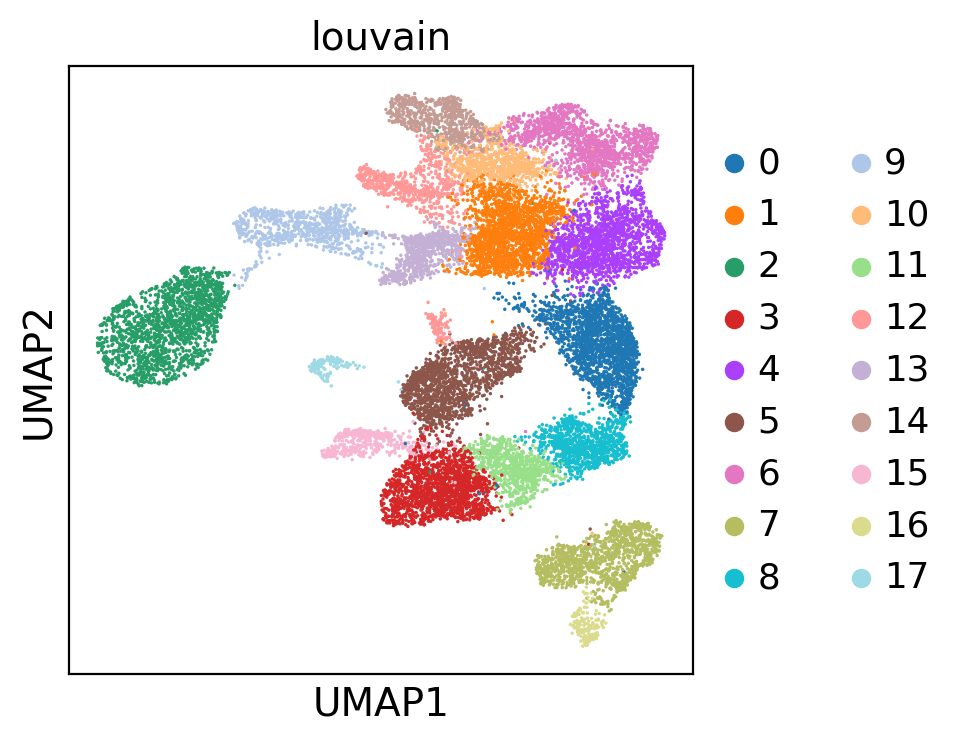

In [52]:
sc.pl.umap(adata, color=[ 'louvain'])

# Plot cistopic scores

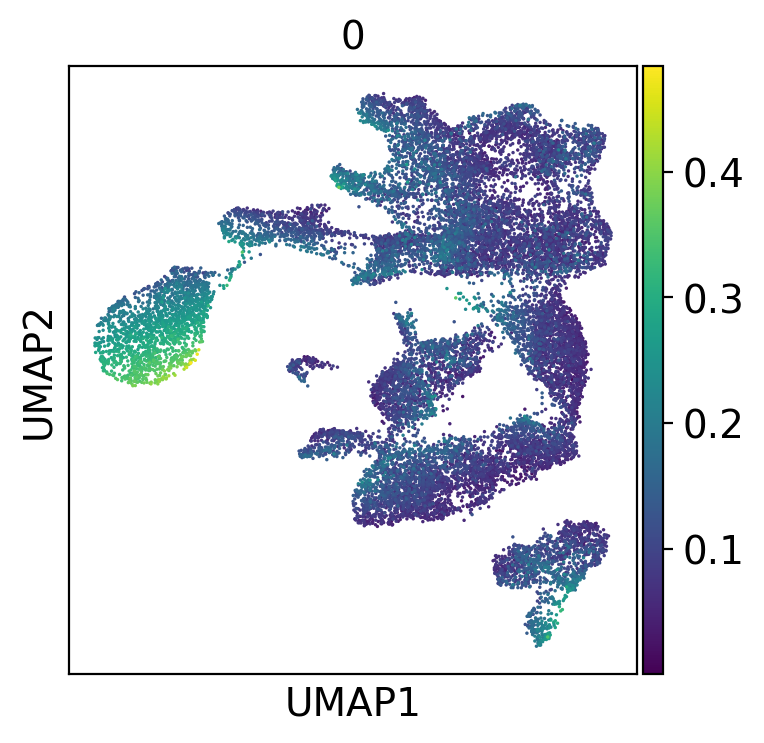

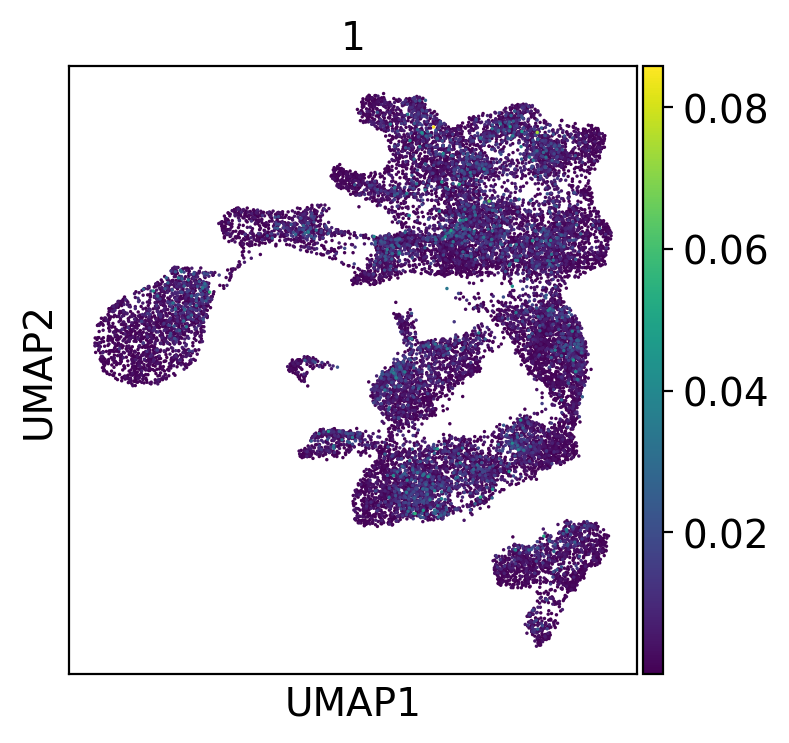

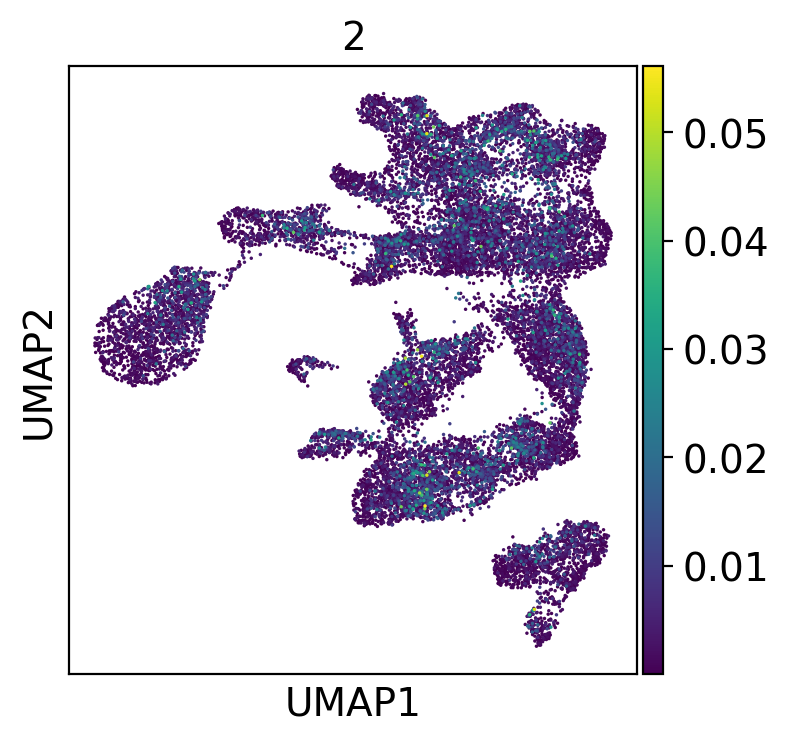

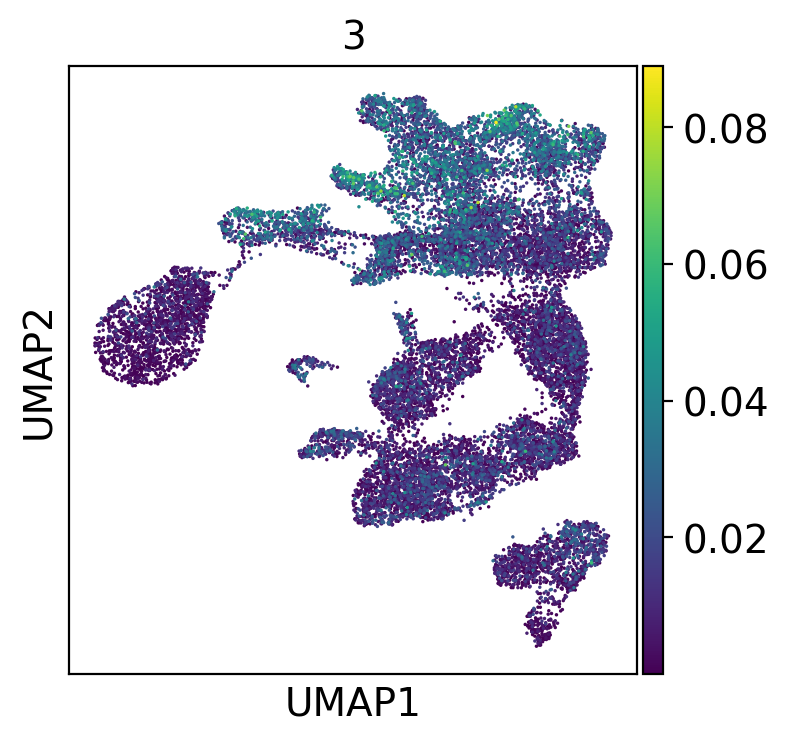

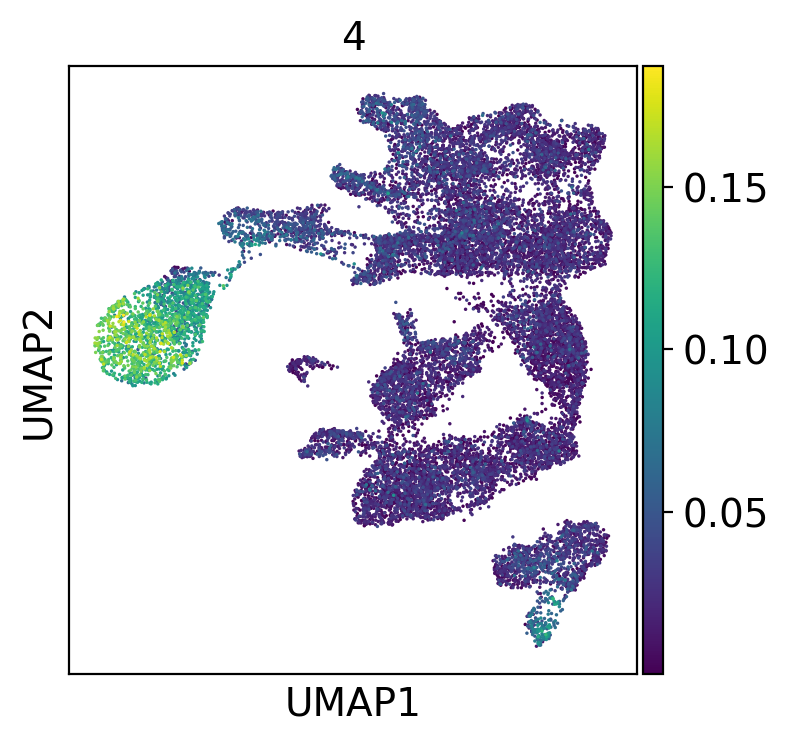

...

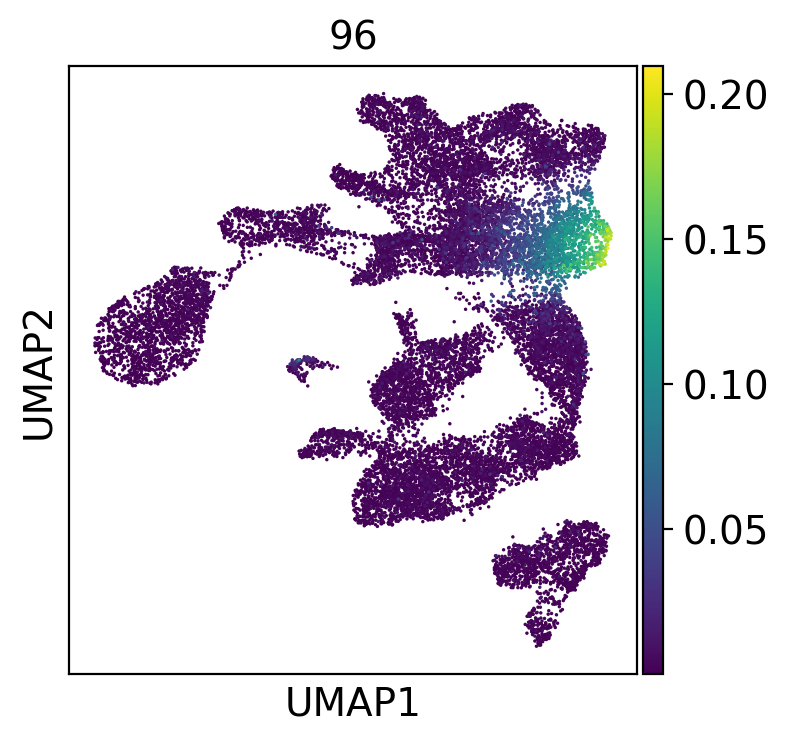

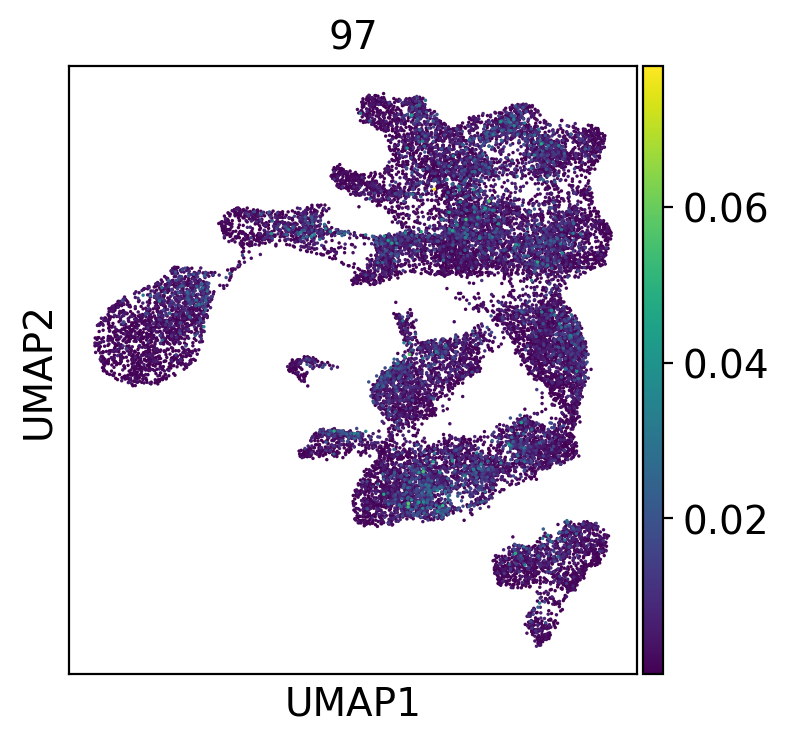

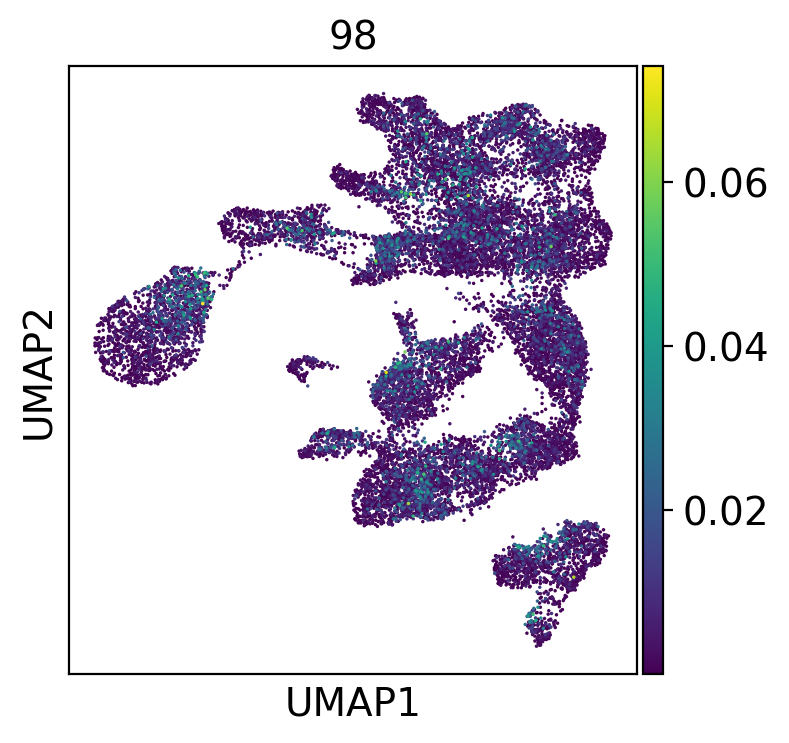

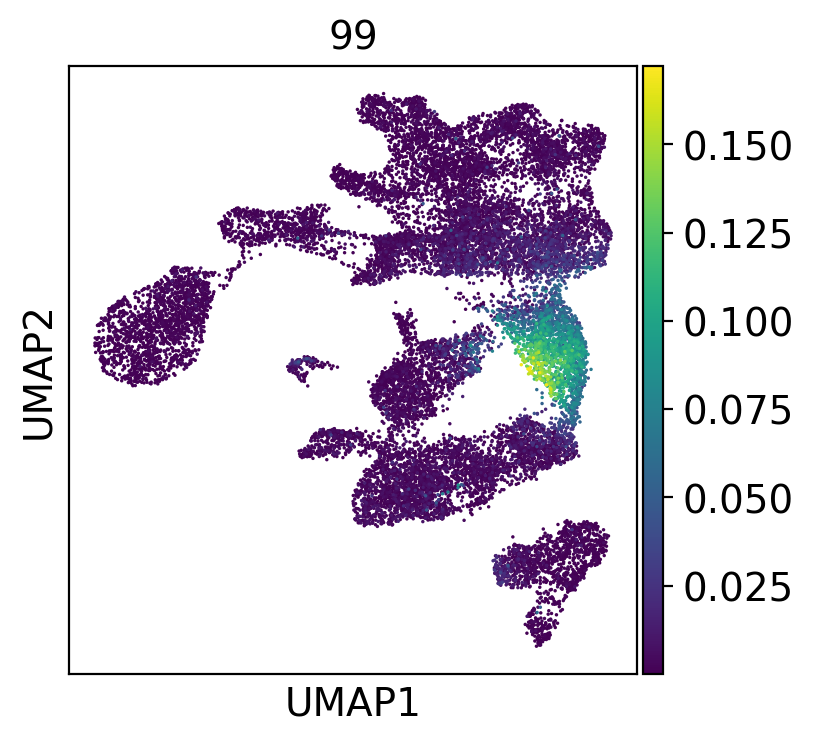

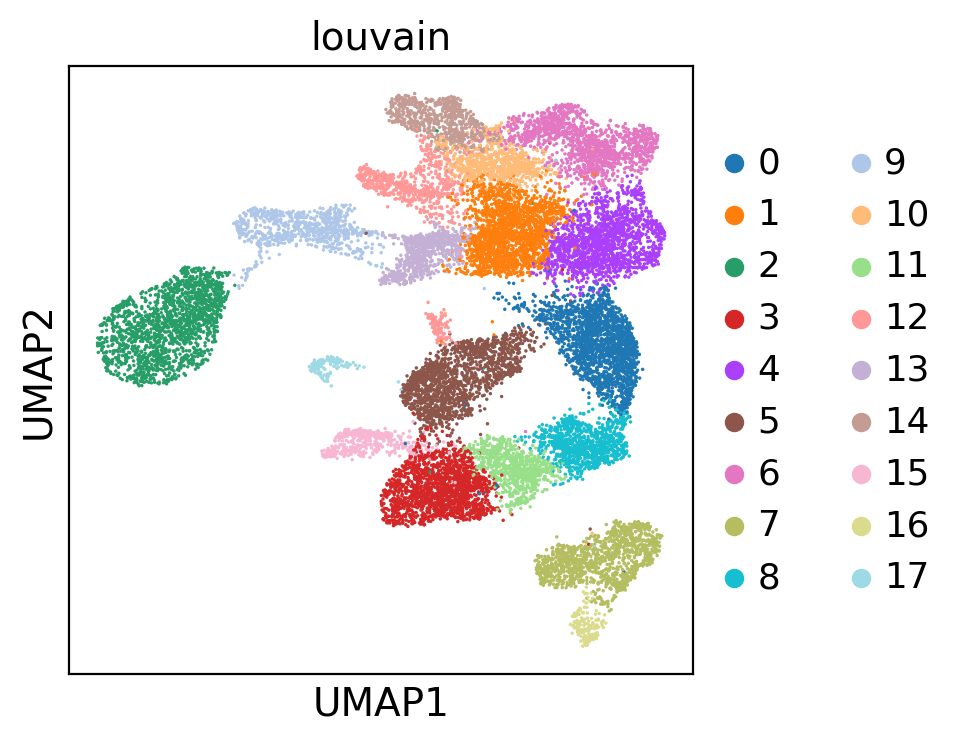

In [53]:
for i in adata.obs:
    sc.pl.umap(adata, color=[i])

# Write files

In [111]:
#save UMAP
UMAP = pd.DataFrame(data=adata.obsm['X_umap'])
UMAP.to_csv(direc + '14_visualisation/data/snATACseq_embryo_revision1_reads_in_peaks_above_24_UMAP.csv', sep=',')

#save clusters

louvain = pd.DataFrame(data=adata.obs['louvain'])
louvain.to_csv(direc + '14_visualisation/data/snATACseq_embryo_revision1_reads_in_peaks_above_24_Louvain.csv', sep=',')

# Count number of cells with regions accessible per cell type

In [65]:
mat = np.zeros((len(adata.var_names), len(np.unique(adata.obs['louvain']))))
count=0
for i in np.unique(adata.obs['louvain']):
    print(i)
    adata_endo = adata[[j == i for j  in adata.obs["louvain"]],:]
    numEndo = np.sum(adata_endo.X,axis=0).tolist()
    print(numEndo[0][0:5])
    mat[:,count] = numEndo[0]
    count+=1
    print(count)

0
[7.0, 8.0, 6.0, 12.0, 27.0]
1
1
[26.0, 11.0, 10.0, 9.0, 8.0]
2
10
[2.0, 4.0, 4.0, 0.0, 6.0]
3
11
[5.0, 4.0, 4.0, 4.0, 35.0]
4
12
[1.0, 1.0, 2.0, 1.0, 2.0]
5
13
[5.0, 2.0, 2.0, 2.0, 3.0]
6
14
[2.0, 9.0, 7.0, 0.0, 5.0]
7
15
[1.0, 1.0, 2.0, 3.0, 14.0]
8
16
[2.0, 0.0, 0.0, 1.0, 0.0]
9
17
[1.0, 0.0, 1.0, 1.0, 0.0]
10
2
[2.0, 2.0, 2.0, 0.0, 3.0]
11
3
[6.0, 5.0, 5.0, 6.0, 48.0]
12
4
[16.0, 9.0, 9.0, 12.0, 14.0]
13
5
[7.0, 9.0, 8.0, 29.0, 18.0]
14
6
[9.0, 5.0, 7.0, 7.0, 11.0]
15
7
[0.0, 7.0, 7.0, 4.0, 9.0]
16
8
[5.0, 7.0, 2.0, 4.0, 37.0]
17
9
[6.0, 0.0, 0.0, 0.0, 2.0]
18


In [66]:
MAT = pd.DataFrame(data=mat)
MAT

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,7.0,26.0,2.0,5.0,1.0,5.0,2.0,1.0,2.0,1.0,2.0,6.0,16.0,7.0,9.0,0.0,5.0,6.0
1,8.0,11.0,4.0,4.0,1.0,2.0,9.0,1.0,0.0,0.0,2.0,5.0,9.0,9.0,5.0,7.0,7.0,0.0
2,6.0,10.0,4.0,4.0,2.0,2.0,7.0,2.0,0.0,1.0,2.0,5.0,9.0,8.0,7.0,7.0,2.0,0.0
3,12.0,9.0,0.0,4.0,1.0,2.0,0.0,3.0,1.0,1.0,0.0,6.0,12.0,29.0,7.0,4.0,4.0,0.0
4,27.0,8.0,6.0,35.0,2.0,3.0,5.0,14.0,0.0,0.0,3.0,48.0,14.0,18.0,11.0,9.0,37.0,2.0
5,5.0,7.0,3.0,4.0,3.0,1.0,3.0,1.0,4.0,0.0,2.0,1.0,3.0,3.0,9.0,4.0,2.0,4.0
6,5.0,5.0,2.0,1.0,2.0,2.0,3.0,0.0,0.0,0.0,1.0,3.0,2.0,5.0,5.0,0.0,2.0,1.0
7,46.0,107.0,36.0,8.0,50.0,24.0,32.0,1.0,0.0,2.0,2.0,17.0,69.0,23.0,14.0,37.0,13.0,8.0
8,2.0,4.0,4.0,0.0,0.0,2.0,4.0,2.0,0.0,0.0,1.0,8.0,7.0,5.0,5.0,5.0,1.0,4.0
9,9.0,6.0,30.0,4.0,13.0,4.0,9.0,2.0,0.0,0.0,2.0,6.0,8.0,7.0,3.0,7.0,4.0,3.0


In [115]:

MAT = pd.DataFrame(data=mat)
MAT.to_csv(direc + '14_visualisation/data/snATACseq_embryo_revision01_pooledNumber_OCR_perCelltype.csv', sep=',')
#save clusters
#save peaks used
CELL = pd.DataFrame(data=np.unique(adata.obs['louvain']))
CELL.to_csv(direc + '14_visualisation/data/snATACseq_embryo_revision01_pooledNumber_OCR_perCelltype_celltypeLabel.csv', sep=',')

PEAK = pd.DataFrame(data=adata.var_names)

PEAK.to_csv(direc + '14_visualisation/data/snATACseq_embryo_revision01_pooledNumber_OCR_perCelltype_peakLabel.csv', sep=',')

In [116]:
MAT.shape

(305187, 18)